In [1]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import textwrap
from mymain import parser, Character, people

characters = parser()
shortened = [
    "King Charles",
    "Cardinal Orsini",
    "Father Mario Maffei",
    "Queen Isabella I",
    "Cardinal della Rovere di Vinovo",
    "Papal Chaplain Alessandro Farnese",
    "Cardinal Federico Sanseverino",
    "Cesare “Valentino” Borgia",
    "Gioacchino Torriani,",
    "Cardinal René de Prie",
    "Cardinal Giovanni Conti",
    "Father Dioneo Farnese",
    "Pierre D’Aubusson",
    "Captain Corella",
    "Francesco Alidosi",
    "Chef Bocca",
    "Caterina Sforza Riario",
    "Cardinal Giovanni Michiel Zen",
    "Cardinal Paolo Campofregoso",
    "Agostino Tillio",
    "Adriano “Hadrian” Castellesi",
    "Cardinal Rodrigo Borgia",
    "Brother Vincenzo Bandello",
    "Cardinal Jorge da Costa",
    "Antonio Pallavicini Gentili",
    "Duchess Anne of Brittany",
    "Cardinal Ippolito d’Este",
    "Raffaele Riario (della Rovere)",
    "Franceschetto Cybo",
    "Cardinal Girolamo",
    "Francesco “Samson” Nanni",
    "Queen Beatrice",
    "Cardinal Giovanni Colonna",
    "King Louis of Orleans",
    "Doctor John Argentine",
    "Cardinal Giuliano della Rovere",
    "Giovanni Battista Zen",
    # "Duke Louis of Orleans",
    "Galahad Sanseverino",
    "Johann Burchard",
    "Cardinal Sforza",
    "Cardinal Oliverio Carafa",
    "Cardinal Guillaume Briçonnet",
    "Brother Constantine (Prince Cem)",
    "Cardinal Matthäus Schiner",
    "Cardinal Pietro Bembo",
    "King Maximilian I",
    "Cardinal Piccolomini",
    "Maffeo Gherardi, Patriarch of Venice",
    "Cardinal Michel de Bucy",
    "Cardinal Giovanni “Leo” de Medici",
    "Brother Tillio",
    "Josquin des Prez",
    "Cardinal Giovanni Battista Savelli",
    "Gherardo Maffei",
    "Cardinal Francesco Soderini",
    "King Henry VII",
    "Giovanni “Achilles” Sangiorgio",
    "Adriano “Hadrian” Castellesi",
    "Brother Annio of Viterbo",
    "Raffaello Maffei “Volterrano”",
    # "Cardinal della Porta Junior",
    "Michele Tarchaniota Marullo",
]

labels = {"the roman mob": "The Roman Mob"}
for i in range(len(shortened)):
    labels[people[i]] = shortened[i]

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_69418/2864439862.py:30: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


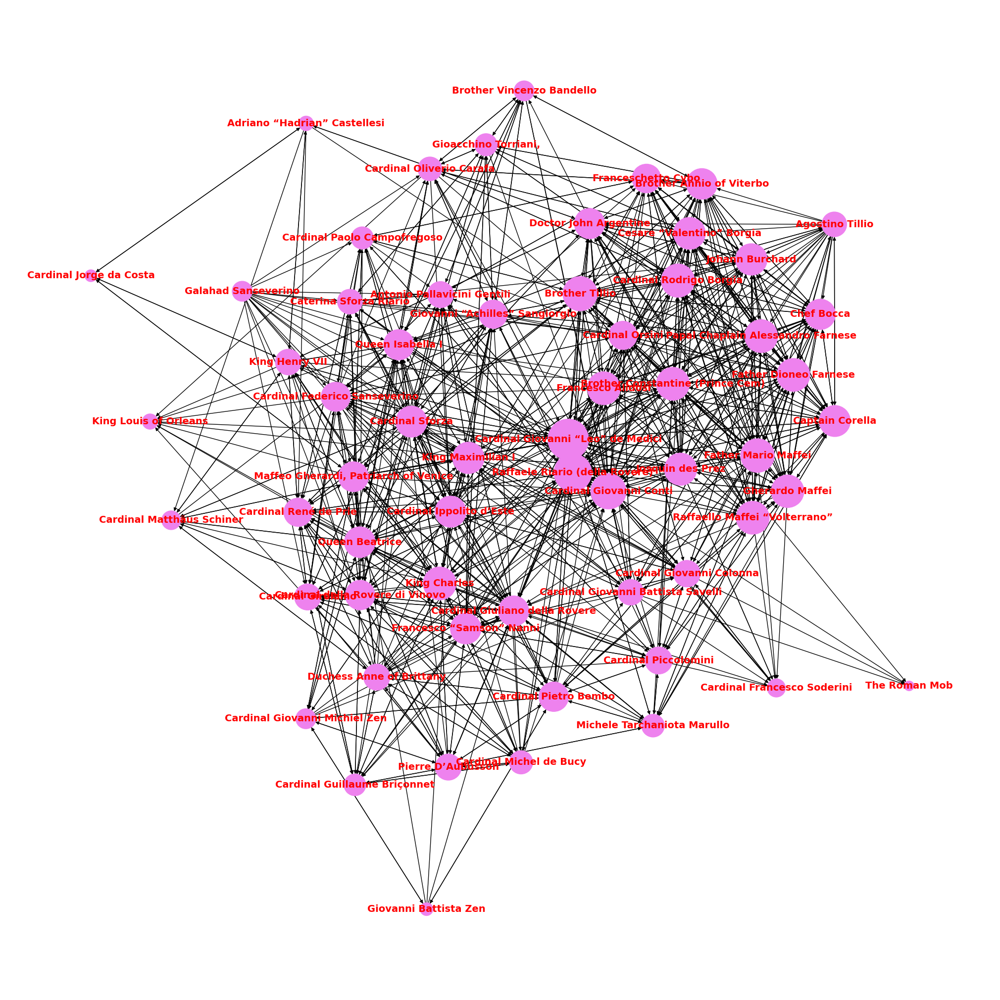

In [3]:
#Create a blank graph page
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()])
        
#Add nodes


# #Add edges
# nxG.add_edge(x, y)

# #Lists
# nodeSizes = [1000, 20]
# color_map = ['red', 'blue']
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (20,20)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
nx.draw(nxG, pos=layout, with_labels=True, font_size=14, node_color=color_map, font_color="red", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_69418/2493622929.py:22: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


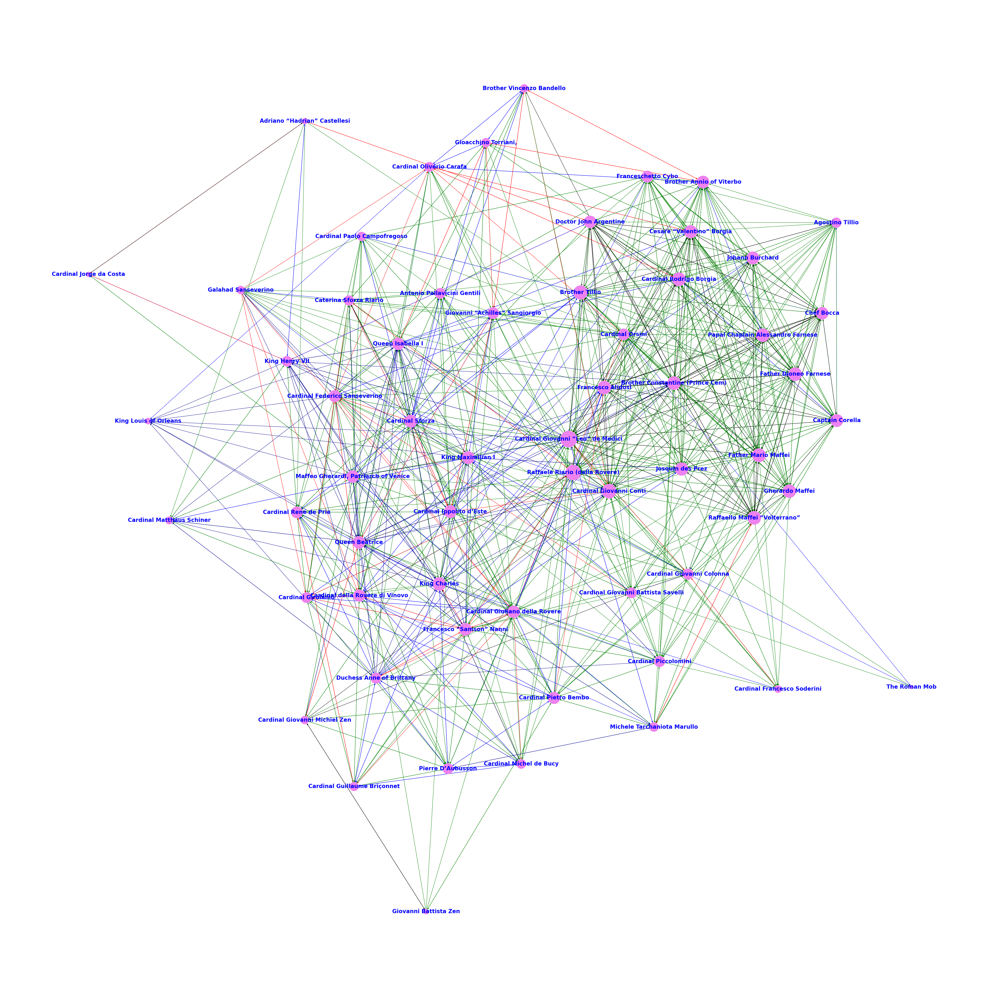

In [6]:
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

colors = {"close ally": "red", "ally": "green", "confidant": "black", "client": "blue", "correspondent": "darkblue", "patron": "blue", "boss": "darkgreen", "colleague": "black"}
# myweights = {"close ally": 5, "ally": 2, "confidant": 2, "client": 1, "correspondent": 1, "patron": 1, "boss": 1, "colleague": 1}
for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()],color=colors[key])
        
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (50,50)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
colorings = nx.get_edge_attributes(nxG,'color').values()
weights = nx.get_edge_attributes(nxG,'weight').values()

nx.draw(nxG, pos=layout, with_labels=True, font_size=20, node_color=color_map, edge_color=colorings, font_color="blue", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_69418/3066182353.py:32: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


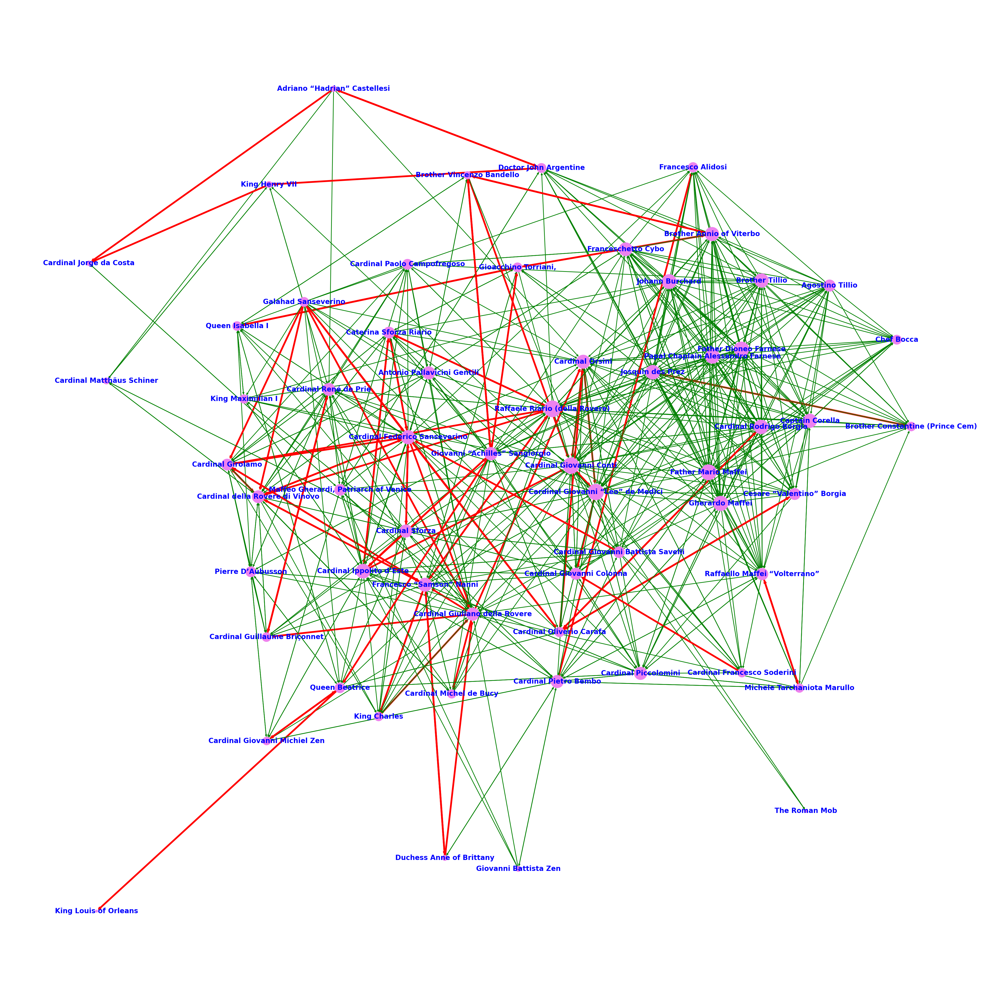

In [11]:
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

colors = {"close ally": "red", "ally": "green", "confidant": "black", "client": "blue", "correspondent": "darkblue", "patron": "blue", "boss": "darkgreen", "colleague": "black"}
myweights = {"close ally": 5, "ally": 2, "confidant": 2, "client": 1, "correspondent": 1, "patron": 5, "boss": 1, "colleague": 1}
for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if "ally" in key:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()],color=colors[key], weight=myweights[key])
        
#Add nodes


# #Add edges
# nxG.add_edge(x, y)

# #Lists
# nodeSizes = [1000, 20]
# color_map = ['red', 'blue']
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (40,40)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
colorings = nx.get_edge_attributes(nxG,'color').values()
weights = nx.get_edge_attributes(nxG,'weight').values()

nx.draw(nxG, pos=layout, with_labels=True, font_size=20, node_color=color_map, edge_color=colorings, width=list(weights), font_color="blue", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

/var/folders/l1/gkkkp_tx023b7x0919gyc83m0000gn/T/ipykernel_69418/2809212568.py:32: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.fillna(df.max().max())


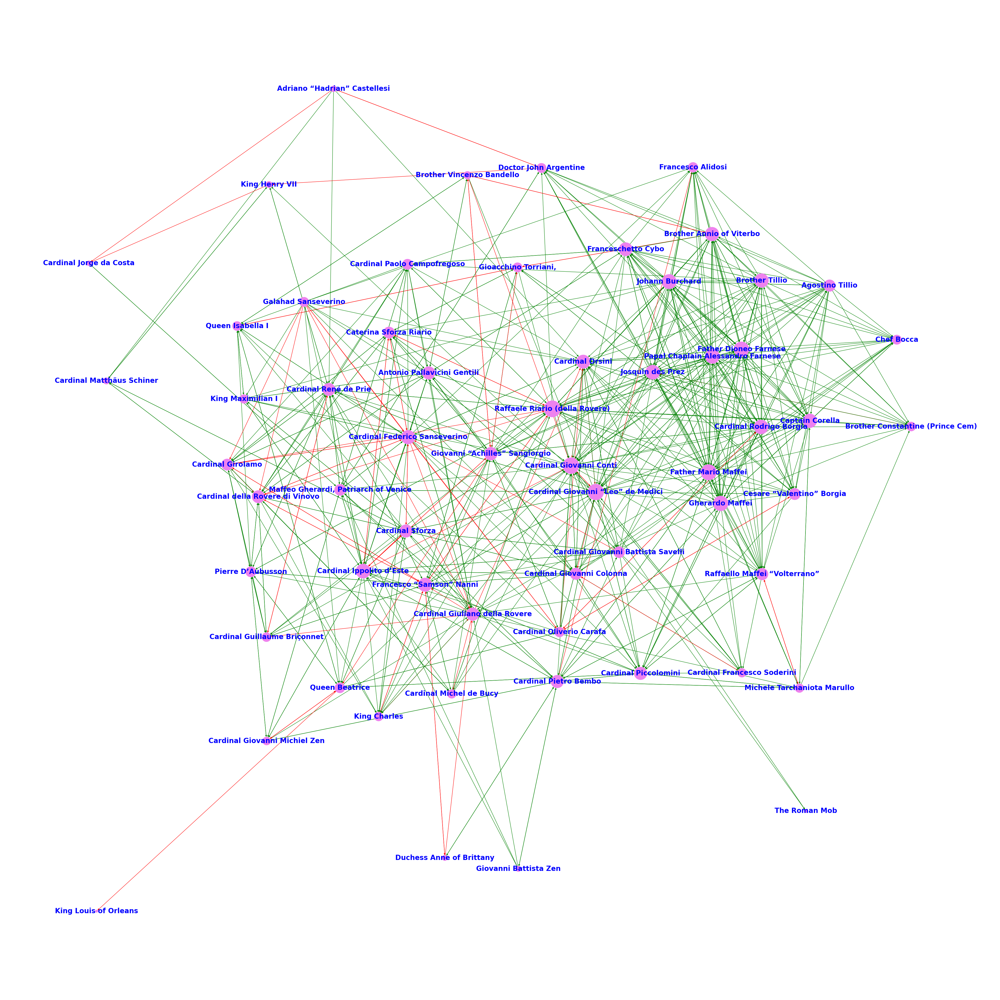

In [10]:
nxG = nx.DiGraph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

colors = {"close ally": "red", "ally": "green", "confidant": "black", "client": "blue", "correspondent": "darkblue", "patron": "blue", "boss": "darkgreen", "colleague": "black"}
# myweights = {"close ally": 5, "ally": 2, "confidant": 2, "client": 1, "correspondent": 1, "patron": 5, "boss": 1, "colleague": 1}
for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if "ally" in key:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()],color=colors[key])
        
df = pd.DataFrame(index=nxG.nodes(), columns=nxG.nodes())
for row, data in nx.shortest_path_length(nxG):
    for col, dist in data.items():
        df.loc[row,col] = dist

df = df.fillna(df.max().max())
layout = nx.kamada_kawai_layout(nxG, dist=df.to_dict())

color_map = []
for node in nxG:
    color_map.append("violet")
plt.rcParams["figure.figsize"] = (40,40)

list_degree=list(nxG.degree())
nodes , degree = map(list, zip(*list_degree)) 
colorings = nx.get_edge_attributes(nxG,'color').values()
weights = nx.get_edge_attributes(nxG,'weight').values()

nx.draw(nxG, pos=layout, with_labels=True, font_size=20, node_color=color_map, edge_color=colorings, font_color="blue", font_weight="bold", node_size=[(v * 50)+1 for v in degree])
plt.show()

In [66]:
"""
Strength of the social network
"""

nxG = nx.Graph(directed=True)

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        # if "ally" in key:
        characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
        for relation in characters[ch].relationsFiltered[key]:
            if relation != characters[ch]:
                nxG.add_edge(name, labels[relation.name.lower()],)

print(nx.algorithms.approximation.average_clustering(nxG))

0.604


In [45]:
"""
Overlapping members of cliques (strong bridges?)
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])

def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

clique = nx.find_cliques(nxG)
# independent_set = nx.approximation.maximum_independent_set(nxG)
# out = intersection(clique, independent_set)
# print(out)

overlaps = {}
for itm in clique:
    for alt in clique:
        if alt != itm:
            test = intersection(alt, itm)
            for n in test:
                if n in overlaps:
                    overlaps[n] += 1
                else:
                    overlaps[n] = 1

for key, value in overlaps.items():
    print(f"{key}: {value}")

Cardinal Ippolito d’Este: 30
Maffeo Gherardi, Patriarch of Venice: 11
Cardinal Giuliano della Rovere: 44
Cardinal Pietro Bembo: 22
Cardinal Giovanni Michiel Zen: 5


In [77]:
"""
Strongest community
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])


for itm in nx.community.k_clique_communities(nxG, 15):
    for a in itm:
        print(a)
    print("\n\n\n")

Cardinal Giovanni “Leo” de Medici
Gherardo Maffei
Franceschetto Cybo
Father Mario Maffei
Papal Chaplain Alessandro Farnese
Agostino Tillio
Josquin des Prez
Captain Corella
Brother Tillio
Father Dioneo Farnese
Brother Annio of Viterbo
Cesare “Valentino” Borgia
Cardinal Rodrigo Borgia
Johann Burchard
Cardinal Giovanni Conti






In [100]:
"""
Those in the most triangles (stable groups)
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()])

res = nx.triangles(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
for k, v in sorted_data.items():
    print(f"{k}: {v}")

Cardinal Giovanni Conti: 219
Raffaele Riario (della Rovere): 213
Father Mario Maffei: 206
Gherardo Maffei: 206
Brother Tillio: 193
Cardinal Rodrigo Borgia: 189
Papal Chaplain Alessandro Farnese: 188
Father Dioneo Farnese: 188
Johann Burchard: 175
Cardinal Giovanni “Leo” de Medici: 174
Captain Corella: 173
Agostino Tillio: 171
Brother Annio of Viterbo: 171
Josquin des Prez: 165
Cardinal Giuliano della Rovere: 154
Franceschetto Cybo: 131
Raffaello Maffei “Volterrano”: 126
Cesare “Valentino” Borgia: 119
Cardinal Orsini: 113
Francesco Alidosi: 103
Cardinal Federico Sanseverino: 100
Cardinal Ippolito d’Este: 98
Cardinal della Rovere di Vinovo: 88
Cardinal Sforza: 84
Chef Bocca: 83
Cardinal René de Prie: 78
Cardinal Pietro Bembo: 74
Cardinal Girolamo: 71
King Charles: 70
Galahad Sanseverino: 69
Brother Constantine (Prince Cem): 69
Francesco “Samson” Nanni: 66
Giovanni “Achilles” Sangiorgio: 65
Cardinal Giovanni Colonna: 63
Antonio Pallavicini Gentili: 62
Cardinal Piccolomini: 60
Cardinal Mic

In [112]:
"""
Communities
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 5, "ally": 4, "confidant": 3, "client": 2, "correspondent": 1, "patron": 5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])

res = nx.community.louvain_communities(nxG)
for itm in res:
    for a in itm:
        print(a)
    print('\n\n')

Cardinal Sforza
Cardinal Paolo Campofregoso
Cardinal Giovanni Battista Savelli
Antonio Pallavicini Gentili
Cardinal Ippolito d’Este
Galahad Sanseverino
Cardinal Giovanni Colonna
King Maximilian I
Cardinal Federico Sanseverino
Caterina Sforza Riario
Cardinal Francesco Soderini
Cardinal Orsini
Brother Vincenzo Bandello
Queen Beatrice
Cardinal Giovanni Conti
Cardinal Oliverio Carafa
Giovanni “Achilles” Sangiorgio
Gioacchino Torriani,
King Louis of Orleans
The Roman Mob
Queen Isabella I
Cardinal Jorge da Costa
King Henry VII
Cardinal Matthäus Schiner
Adriano “Hadrian” Castellesi
King Charles
Cardinal Girolamo
Pierre D’Aubusson
Cardinal Michel de Bucy
Cardinal René de Prie
Cardinal Giuliano della Rovere
Francesco “Samson” Nanni
Cardinal della Rovere di Vinovo
Cardinal Guillaume Briçonnet
Duchess Anne of Brittany
Raffaele Riario (della Rovere)
Father Mario Maffei
Josquin des Prez
Captain Corella
Father Dioneo Farnese
Johann Burchard
Brother Tillio
Raffaello Maffei “Volterrano”
Gherardo Maffe

In [ ]:
"""
Communities
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 5, "ally": 4, "confidant": 3, "client": 2, "correspondent": 1, "patron": 5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms:
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])

res = nx.community.louvain_communities(nxG)
for itm in res:
    for a in itm:
        print(a)
    print('\n\n')

In [120]:
"""
Strongest individuals
"""

nxG = nx.Graph()

terms = ["close ally", "ally", "allies", "confidant", "patron"]
myweights = {"close ally": 5, "ally": 4, "confidant": 3, "client": 2, "correspondent": 1, "patron": 5, "boss": 2, "colleague": 1}

for i, ch in enumerate(characters):
    name = labels[ch]
    nxG.add_node(name)

for ch in characters:
    name = labels[ch]
    for key in characters[ch].relations:
        if key in terms: # try toggling this!
            characters[ch].relationsFiltered[key] = list(set(characters[ch].relationsFiltered[key]))
            for relation in characters[ch].relationsFiltered[key]:
                if relation != characters[ch]:
                    nxG.add_edge(name, labels[relation.name.lower()], weight=myweights[key])

res = nx.degree_centrality(nxG)
sorted_data = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
for k, v in sorted_data.items():
    print(f"{k}: {v}")

Cardinal Giovanni Conti: 0.75
Cardinal Giovanni “Leo” de Medici: 0.6666666666666666
Raffaele Riario (della Rovere): 0.5333333333333333
King Charles: 0.48333333333333334
Cardinal Giuliano della Rovere: 0.48333333333333334
Brother Constantine (Prince Cem): 0.48333333333333334
Francesco Alidosi: 0.4666666666666667
Cardinal Orsini: 0.43333333333333335
Father Mario Maffei: 0.43333333333333335
Cardinal Rodrigo Borgia: 0.43333333333333335
Brother Tillio: 0.43333333333333335
Gherardo Maffei: 0.43333333333333335
Raffaello Maffei “Volterrano”: 0.43333333333333335
Queen Isabella I: 0.4166666666666667
Cardinal Ippolito d’Este: 0.4166666666666667
Josquin des Prez: 0.4166666666666667
Papal Chaplain Alessandro Farnese: 0.4
Cardinal Federico Sanseverino: 0.4
Cesare “Valentino” Borgia: 0.4
Father Dioneo Farnese: 0.4
Queen Beatrice: 0.4
King Maximilian I: 0.4
Brother Annio of Viterbo: 0.4
Captain Corella: 0.3833333333333333
Johann Burchard: 0.3833333333333333
Cardinal Sforza: 0.3833333333333333
Chef Boc